# Лабораторная работа №2
## Продвинутые методы
***
Авторы: Заречнев Алексей, Петрасюк Алексей, Халили Алина, Галимова Ярослава (все - счастливые обитатели группы M3236)  
[Ссылка на репозиторий](https://github.com/3ELEHblE-LIJanki/Optimization-Methods-lab2)  
Командное фото для поднятия духа: 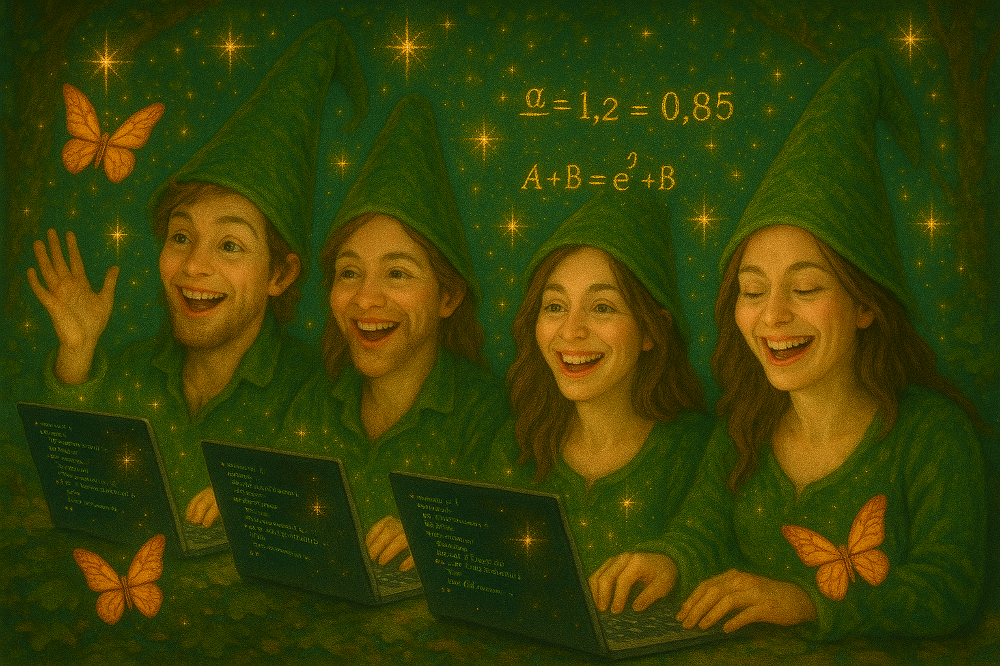

В данной лабораторной работе нами был реализован метод Ньютона. Его можно найти в файле `newton.py` в репозитории [`lib`](https://github.com/3ELEHblE-LIJanki/Optimization-lib/tree/08f159d6b4ff8b11ee9a361be8e92b438ea8a6f8), на который ведёт сабмодуль [этого](https://github.com/3ELEHblE-LIJanki/Optimization-Methods-lab2) репозитория. Главная цель прежняя — найти точку минимума функции. Только теперь мы оперируем методом **второго порядка**, то есть нас интересует вторая производная функции. Здесь тоже всё как раньше - мы используем уже реализованные нами вспомогательные методы из `lrs.py` и классы для рисования графиков из прошлой лабораторной работы. В чём глобальное отличие?  

Если простыми словами, то градиентный спуск говорит: «Иди вниз по склону по направлению наискорейшего убывания функции», в то время как метод Ньютона несколько умнее: он не только смотрит на уклон, но и учитывает то, как быстро меняется уклон. Это напоминает стратегии выбора шага Вольфе или Гольдштейна, которые проверяли походи условия, но при этом опирались только на градиент (то есть являлись методами первого порядка). Давайте посмотрим, как это работает на практике и сравним результаты.

### Задание 1. Метод Ньютона с выбором шага и с одномерным поиском

Метод Ньютона использует вторые производные (гессиан) для учета кривизны функции. Он аппроксимирует функцию квадратичной формой и находит минимум этой аппроксимации. А как мы умеем аппроксимировать? По Тейлору!  
$f(x_k + p) = f(x_k) + grad(f(x_k)) * p + 1/2 * p^T * H(f(x_k))*p + o(x_k^{2})$    
$H$ - гессиан (иначе - матрица вторых производных или, как мы обозначали на матане, $d^2f$)  

Тогда следующий шаг будет вычисляться как $x_{k+1} = x_k + l * H^{-1}*grad(f(x_k))$  
Мы же используем функцию `boundize`, чтобы оставаться в заданных рамках, а так же в нашем случае есть `l` - learning_rate_shedule, которая по умолчанию равна 1 (в классическом методе Ньютона), но мы также можем адаптировать наш метод и превратить его в **damped Newton method**.  
Наша реализация выглядит следующим образом:

```
    def find_min(self, start, max_iterations):
        """
            :param start: List[float] - стартовая точка, в которой начнём поиск
            :param max_iterations: int - максимальное количество итераций спуска
            :return: - минимум полученный в ходе спуска
        """
        self.__init(start)
        for i in range(max_iterations):
            self.path.append(self.x)
            G = np.array(gradient(self.f, self.x, self.eps))
            if np.linalg.norm(G) <= self.eps:
                break
            H = np.array(hessian(self.f, self.x, self.eps))
            l = self.learning_rate_scheduling(self.x, i, self.f, self.bounds)
            self.x = boundize(np.array(self.x) - l * np.linalg.inv(H).dot(G), self.bounds)
    
        return self.f(self.x)
```

#### Квадратичная функция $x^2 + 100y^2$

In [ ]:
import sys
sys.path.insert(0, "./lib")
from gradient_descent import GradientDecent
from graphics_plotter import GraphicsPlotter
from lrs import *
from newton import NewtonCG
from linear_algo import dichotomy
from function_wrapper import FunctionWrapper
from output import pretty_print
import math

func = FunctionWrapper(lambda x: x[0] ** 2 + 100 * x[1] ** 2)

func.clear()
gradient.clear()
hessian.clear()
linear_search = GradientDecent(exponential_decay(0.01, 0.001), func, [[-6.0, 6.0], [-6.0, 6.0]], 0.0001)
test_painter_1 = GraphicsPlotter(linear_search)
res_1 = linear_search.find_min([5, 3], 1000)
pretty_print(linear_search, "EXP", res_1, gradient, hessian)

func.clear()
gradient.clear()
hessian.clear()
newton_cg = NewtonCG(constant(1), func, [[-6.0, 6.0], [-6.0, 6.0]], 0.0001)
test_painter_2 = GraphicsPlotter(newton_cg)
res_2 = newton_cg.find_min([5, 3], 1000)
pretty_print(newton_cg, "NEW", res_2, gradient, hessian)

test_painter_1.plot("EXP")
test_painter_2.plot("NEWTON")

**Вывод**: на квадратичных функциях метод Ньютона работает гораздо лучше и даже точнее. Это связано с тем, что мы аппроксимируем функцию ей же самой. В теории мы должны были справиться за 1 шаг, но с учётом погрешностей при счёте здесь мы сделали два шага. Тем не менее, это в разы меньше числа шагов для градиентного спуска, например, с экспоненциальным затуханием

#### "Банановая функция" или функция Розенброка $(1 - x)^2 + 100(y-x^2)^2$

Метод Ньютона может страдать от плохой обусловленности гессиана вдали от минимума. Градиентный спуск будет "зигзагообразно" медленно сходиться.  

Вдоль кривой $y = x^2$ функция сходится медленно и, как следствие, в этих точках определитель гессиана практически нулевой, что приводит нас к неточным, но при этом большим шагам. А вдали от этой кривой мы наоборот делаем слишком маленькие шаги, что приводит к увеличению их количества.   

Минимум достигается в точке (1, 1), значение - 0.

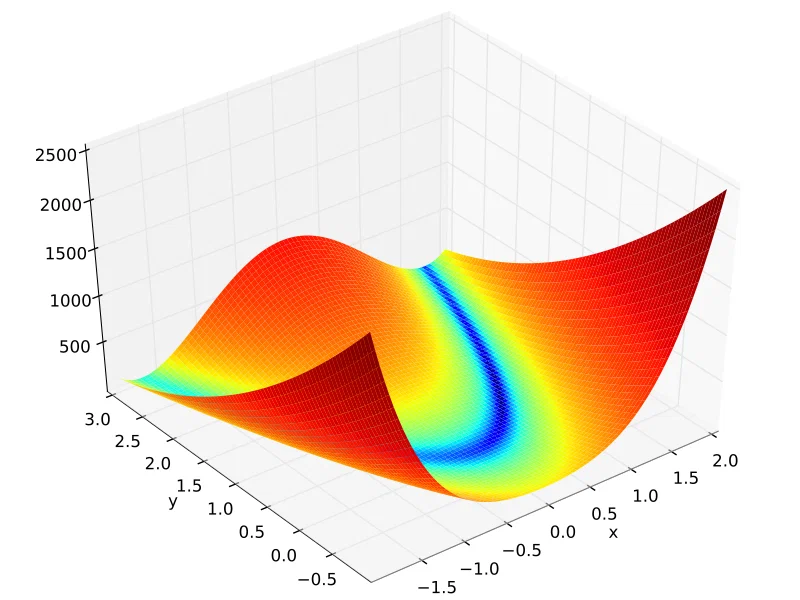

In [ ]:
import sys
sys.path.insert(0, "./lib")
from gradient_descent import GradientDecent
from graphics_plotter import GraphicsPlotter
from lrs import *
from newton import NewtonCG
from linear_algo import dichotomy
from function_wrapper import FunctionWrapper
from output import pretty_print
import math

func = FunctionWrapper(lambda x: (1 - x[0]) ** 2 + 100 * (x[1] - x[0] ** 2) ** 2)

func.clear()
gradient.clear()
hessian.clear()
linear_search = GradientDecent(goldstein(0.3), func, [[-1.5, 1.5], [-1.5, 1.5]], 0.00001)
test_painter_1 = GraphicsPlotter(linear_search)
res_1 = linear_search.find_min([-1, 0], 150)
pretty_print(linear_search, "WOLFE", res_1, gradient, hessian)

func.clear()
gradient.clear()
hessian.clear()
newton_cg = NewtonCG(constant(1), func, [[-1.5, 1.5], [-1.5, 1.5]], 0.00001)
test_painter_2 = GraphicsPlotter(newton_cg)
res_2 = newton_cg.find_min([-1, 0], 150)
pretty_print(newton_cg, "NEW_GOOD", res_2, gradient, hessian)

test_painter_1.plot("GOLD")
test_painter_2.plot_3d("GOOD NEWTON")

**Вывод:**
Если корректно подобрать стартовую точку, то и на плохо обусловленных функциях метод Ньютона может довольно быстро (особенно в сравнении с методом градиентного спуска) и корректно находить минимум. Вопрос только в том, что иногда выбор стартовой точки - ничуть не менее застратная по производительности задача. Оставим это как интересное наблюдение.

А вот как это будет работать с небольшой коррекцией - мы будем говорить, что "доверяем" только небольшой окрестности вокруг стартовой точки на текущей итерации. Как это можно ограничить? Либо подредактировать метод Ньютона и, например, внутри него проверять такие условия, как Вольфе, Армихо и так далее. Либо можно просто масштабировать наш шаг. Например, в качестве lrs передавать чуть меньшую константу.

In [19]:
func = FunctionWrapper(lambda x: (1 - x[0]) ** 2 + 100 * (x[1] - x[0] ** 2) ** 2)

func.clear()
gradient.clear()
hessian.clear()
newton_cg = NewtonCG(constant(0.1), func, [[-3, 3], [-3, 3]], 0.00001)
test_painter_2 = GraphicsPlotter(newton_cg)
res_2 = newton_cg.find_min([-2, 2], 350)
pretty_print(newton_cg, "NEW_GOOD_LRS", res_2, gradient, hessian)

test_painter_2.plot("NEW_GOOD_LRS")


        NEW_GOOD_LRS
            found result:         0.000000
            found result in:      ['0.99999855240091339859', '0.99999707722102160190']
            steps count:          306
            function calls count: 4068
            gradient calls count: 306
            hessian calls count:  305
          


И вот как из той же стартовой точки будет работать не дэмпированный метод Ньютона. Эта функция не очень сложная, она унимодальная и в этом её преимущество. Как раз на неё хорошо видно, как метод Ньютона даже без lrs справляется на ура, в отличие от долгого и затратного по времени метода градиентного спуска. Тем не менее, с lrs метод работает и ничуть не проигрывает по сложности. На функциях с более сложым поведением это могло бы сыграть свою роль.

In [21]:
func = FunctionWrapper(lambda x: (1 - x[0]) ** 2 + 100 * (x[1] - x[0] ** 2) ** 2)

func.clear()
gradient.clear()
hessian.clear()
newton_cg = NewtonCG(constant(1), func, [[-3, 3], [-3, 3]], 0.00001)
test_painter_2 = GraphicsPlotter(newton_cg)
res_2 = newton_cg.find_min([-2, 2], 350)
pretty_print(newton_cg, "NEW_GOOD_LRS", res_2, gradient, hessian)

test_painter_2.plot("NEW_GOOD_LRS")


        NEW_GOOD_LRS
            found result:         0.000000
            found result in:      ['1.00000004230547268058', '1.00000008460227540752']
            steps count:          18
            function calls count: 237
            gradient calls count: 18
            hessian calls count:  17
          


Кстати, здесь также очень хорошо видно, что пока мы находимся в самой "банановой долине" и движемся вдоль этой параболы, нас откидывает далеко от неё, а находясь вне "долины" мы сразу скатываемся в неё. Это связано с 

#### Функция Химмельблау $(x^2 + y - 11)^2 + (x + y^2 - 7)^2$

Функция имеет **4 локальных минимума и седловые точки**, что делает её интересной для анализа поведения алгоритмов. Мы не ожидаем корректной работы, поскольку у функции есть седловые точки и она является мультимодальной, но тем не менее метод Ньютона должен проделать хотя бы несколько шагов, что даст нам хорошую почву для дальнейшего анализа.

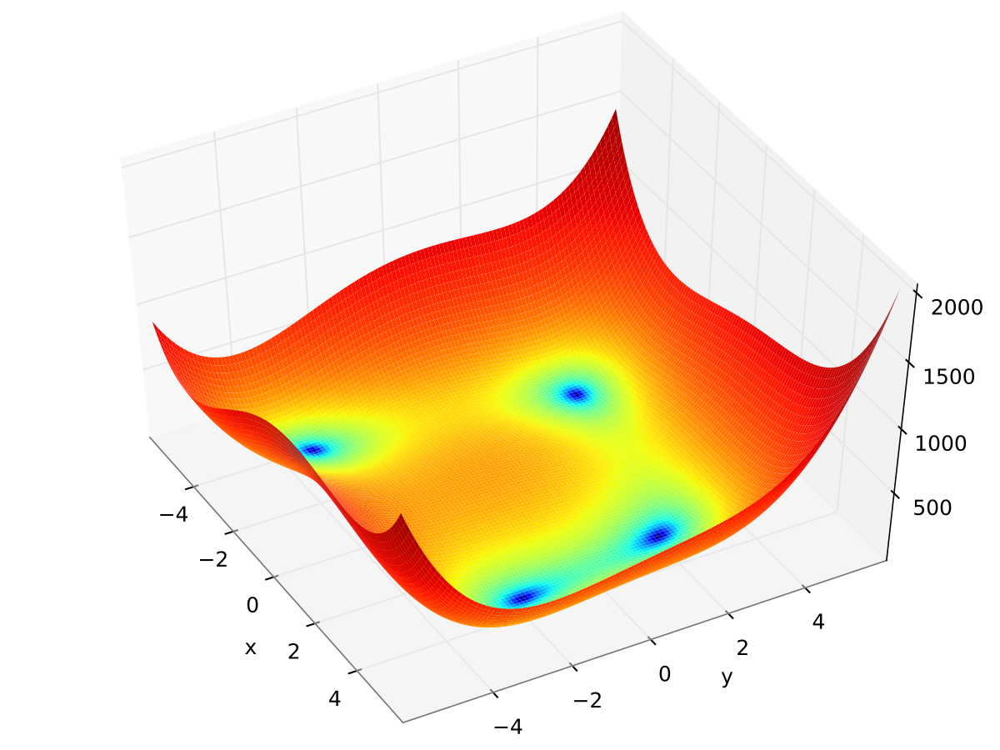

In [5]:
import sys
sys.path.insert(0, "./lib")
from gradient_descent import GradientDecent
from graphics_plotter import GraphicsPlotter
from lrs import *
from newton import NewtonCG
from linear_algo import dichotomy
from function_wrapper import FunctionWrapper
from output import pretty_print
import math

func = FunctionWrapper(lambda x: (x[0]**2 + x[1] - 11)**2 + (x[0] + x[1]**2 - 7)**2)

func.clear()
gradient.clear()
hessian.clear()
linear_search = GradientDecent(polynomial_decay(1, 0.8), func, [[-6.0, 6.0], [-6.0, 6.0]], 0.0001)
test_painter_1 = GraphicsPlotter(linear_search)
res_1 = linear_search.find_min([0, -5], 1000)
pretty_print(linear_search, "POLY", res_1, gradient, hessian)

func.clear()
gradient.clear()
hessian.clear()
newton_cg = NewtonCG(constant(1), func, [[-6.0, 6.0], [-6.0, 6.0]], 0.0001)
test_painter_2 = GraphicsPlotter(newton_cg)
res_2 = newton_cg.find_min([0, -5], 1000)
pretty_print(newton_cg, "NEW", res_2, gradient, hessian)

func.clear()
gradient.clear()
hessian.clear()
newton_cg_3 = NewtonCG(constant(1), func, [[-6.0, 6.0], [-6.0, 6.0]], 0.0001)
test_painter_3 = GraphicsPlotter(newton_cg_3)
res_3 = newton_cg_3.find_min([3, -5], 1000)
pretty_print(newton_cg_3, "NEW", res_3, gradient, hessian)

test_painter_1.plot("POLY")
test_painter_2.plot("NEWTON_BAD")
test_painter_3.plot("NEWTON_GOOD")


        POLY
            found result:         0.000089
            found result in:      ['3.58420195030674282322', '-1.84564604310270086174']
            steps count:          94
            function calls count: 329
            gradient calls count: 84
            hessian calls count:  0
          

        NEW
            found result:         178.337239
            found result in:      ['-0.12796134744546722173', '-1.95371497662205806378']
            steps count:          8
            function calls count: 97
            gradient calls count: 8
            hessian calls count:  7
          

        NEW
            found result:         0.000000
            found result in:      ['3.58442836214756832547', '-1.84812678248965056582']
            steps count:          7
            function calls count: 84
            gradient calls count: 7
            hessian calls count:  6
          


Во-первых, это функция с седловыми точками. Там гессиан не будет положительно определён, и, как следствие, метод просто не будет работать, если окажется в одной из таких точек. Но так как функцию мы вызываем не из такой точки, то можно рискнуть и запустить метод - он будет работать крайне быстро, но важно следить, чтобы функция не "упала" из-за проблем с гессианом в седловой точке.   
Во-вторых, это функция с несколькими минимумами. Поэтому, конечно, мы просто ожидали, что методы приведут нас в какую-нибудь одну из точек локального минимума среди этих четырёх. Так и вышло, что подтверждает корректность работы. Просто нам было интересно пронаблюдать за тем, как метод будет вести себя на функциях с нестандартным поведением. 

#### Функция с седловой точкой $6x^2 + 4xy - 3y^2 + 4(x + 2y) + 22$

In [6]:
import sys
sys.path.insert(0, "./lib")
from gradient_descent import GradientDecent
from graphics_plotter import GraphicsPlotter
from lrs import *
from newton import NewtonCG
from linear_algo import dichotomy
from function_wrapper import FunctionWrapper
from output import pretty_print
import math

func = FunctionWrapper(lambda x: 6 * x[0] ** 2 + 4 * x[0] * x[1] - 3 * x[1] ** 2 + 4 * (x[0] + 2 * x[1]) + 22)

func.clear()
gradient.clear()
hessian.clear()
newton_cg = NewtonCG(constant(1), func, [[-6.0, 6.0], [-6.0, 6.0]], 0.0001)
test_painter_2 = GraphicsPlotter(newton_cg)
res_2 = newton_cg.find_min([-4, -3], 1000)
pretty_print(newton_cg, "NEW_SADDLE", res_2, gradient, hessian)

test_painter_2.plot("NEWTON_SADDLE")


        NEW_SADDLE
            found result:         24.363636
            found result in:      ['-0.63636340305339000878', '0.90909119050049858046']
            steps count:          2
            function calls count: 20
            gradient calls count: 2
            hessian calls count:  1
          


Как мы видим, метод Ньютона просто приходит в седловую точку и останавливается там, хотя количество доступных шагов ненулевое. Это ожидаемое поведение метода Ньютона.   
Метод Ньютона завершает работу при `||grad(f(x))|| ≈ 0` (или если закогчилось число доступных шагов, что неверно для нашего случая). В седловой точке:  
1. Градиент равен нулю (как и в минимуме), но гессиан не положительно определён (есть отрицательные собственные значения).  
2. Направление шага $x_{k+1} = x_k - H^{-1}grad(f(x_{k})$ становится некорректным:  
   - При `grad(f) = 0` алгоритм останавливается.  
   - При малом `grad(f)` может двигаться в сторону максимума.  
Давайте попробуем немного поменять стратегию выбора шага в методе Ньютона.

In [7]:
import sys
sys.path.insert(0, "./lib")
from gradient_descent import GradientDecent
from graphics_plotter import GraphicsPlotter
from lrs import *
from newton import NewtonCG
from linear_algo import dichotomy
from function_wrapper import FunctionWrapper
from output import pretty_print
import math

func = FunctionWrapper(lambda x: 6 * x[0] ** 2 + 4 * x[0] * x[1] - 3 * x[1] ** 2 + 4 * (x[0] + 2 * x[1]) + 22)

func.clear()
gradient.clear()
hessian.clear()
newton_cg = NewtonCG(constant(0.7), func, [[-6.0, 6.0], [-6.0, 6.0]], 0.0001)
test_painter_2 = GraphicsPlotter(newton_cg)
res_2 = newton_cg.find_min([-4, -3], 1000)
pretty_print(newton_cg, "NEW_SADDLE", res_2, gradient, hessian)

test_painter_2.plot("NEWTON_SADDLE")


        NEW_SADDLE
            found result:         24.363636
            found result in:      ['-0.63636542393740958001', '0.90908883163878662081']
            steps count:          13
            function calls count: 163
            gradient calls count: 13
            hessian calls count:  12
          


Мы видим, что когда мы изменили константу, функция начинает совершать большее число меньших по длине шагов (что в нашем случае может предотвратить ошибку!), но, к сожалению, этого не произошло. Давайте поэксперементируем дальше.

In [5]:
import sys
sys.path.insert(0, "./lib")
from gradient_descent import GradientDecent
from graphics_plotter import GraphicsPlotter
from lrs import *
from newton import NewtonCG
from linear_algo import dichotomy
from function_wrapper import FunctionWrapper
from output import pretty_print
import math

func = FunctionWrapper(lambda x: 6 * x[0] ** 2 + 4 * x[0] * x[1] - 3 * x[1] ** 2 + 4 * (x[0] + 2 * x[1]) + 22)

func.clear()
gradient.clear()
hessian.clear()
newton_cg = NewtonCG(goldstein(0.2), func, [[-6.0, 6.0], [-6.0, 6.0]], 0.0001)
test_painter_2 = GraphicsPlotter(newton_cg)
res_2 = newton_cg.find_min([-4, -3], 1000)
pretty_print(newton_cg, "NEW_SADDLE_LRS", res_2, gradient, hessian)

#test_painter_2.plot("NEWTON_SADDLE")


        NEW_SADDLE_LRS
            found result:         24.363636
            found result in:      ['-0.63636897726222407812', '0.90908470210056724348']
            steps count:          101
            function calls count: 2501
            gradient calls count: 301
            hessian calls count:  100
          


Попробовали. Не получилось. Мы действительно пытаемся урегулировать шаги с помощью `learning rate schedule`, их количество увеличивается, но мы всё равно рано или поздно застреваем в седловой точке.

Кстати, небольшое замечание про работу метода Ньютона. Если мы хотя бы на одном шаге получаем сингулярную матрицу (то есть такую, определитель которой равен нулю), наш метод сразу падает, выдавая следующий traceback. Это абсолютно ожидаемое поведение, так как дальнейшая работа будет действительно невозможна.  
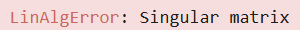

#### 

### Задание 2. Сравнение с библиотекой `scipy.optimize`. Метод Newton-CG и квазиньютоновские методы

### Задание 3. Квазиньютоновский метод

Одной из основных проблем метода Ньютона является то, что он метод 2го порядка, а значит требует вычисления Гессиана, что занимает очень много времени. Одной из оптимизаций может послужить обновление Гессиана лишь раз в несколько итераций, но вычисление обратной матрицы тоже очень затратная операция. Чтобы избежать этих затрат, были изобретены квазиньютоновские методы, они не вычисляют Гессиан на каждой итерации, а лишь приблизительно оценивают вид его обратно матрицы, благодаря чему ассимптотика итерации становится не $O(d^3)$, а $O(d^2)$ где d - размерность функции. Для реализации мы выбрали алгоритм Бройдена — Флетчера — Гольдфарба — Шанно (BFGS). Главной его особенностью является вычисление обратной матрицы Гессианы с помощью рекурентной формулы: $C_{k+1} = (I - r * s * y^T)C_k(I - r * y - s^T) + p * s * s^T$, где $r = \frac{1}{y^T*s}$, $y = x_{new} - x$, $s = grad(x_{new}) - grad(x)$

In [1]:
import sys
sys.path.insert(0, './lib')
from bfgs import BFGS
from newton import NewtonCG
from lrs import gradient, hessian, constant
from function_wrapper import FunctionWrapper
from output import pretty_print
from graphics_plotter import GraphicsPlotter

In [ ]:
func = lambda: FunctionWrapper(lambda x: 3 * x[0]**2 + x[1]**2 - x[1] + 2)

bounds = [[-10, 15], [-10, 15]]

bfgs = BFGS(func(), bounds)
newton = NewtonCG(constant(1), func(), bounds)

x = [-2, -7]
steps = 1000

gradient.clear()
res1 = bfgs.find_min(x, steps)
pretty_print(bfgs, "BFGS", res1, gradient)

hessian.clear()
gradient.clear()
res2 = newton.find_min(x, steps)
pretty_print(newton, "NewtonCG", res2, gradient, hessian)

plotter1 = GraphicsPlotter(bfgs)
plotter2 = GraphicsPlotter(newton)
plotter1.plot()
plotter2.plot()

Данный тест показывает, что метод BFGS делает не отстаёт в точности от метода Ньютона, при этом не обращая Гессиан, а значит каждая итерация требует $O(dim^2)$ действий, да, в случае функций 2 переменных, константа такая, что BFGS делает больше операций, но посмотрим как ведёт себя данный метод на других функциях.

In [ ]:
func = lambda: FunctionWrapper(lambda x: 3 * x[0]**2 + x[1]**4 - x[1] + 2)

bounds = [[-10, 15], [-10, 15]]

bfgs = BFGS(func(), bounds)
newton = NewtonCG(constant(1), func(), bounds)

x = [-2, -7]
steps = 1000

gradient.clear()
res1 = bfgs.find_min(x, steps)
pretty_print(bfgs, "BFGS", res1, gradient)

hessian.clear()
gradient.clear()
res2 = newton.find_min(x, steps)
pretty_print(newton, "NewtonCG", res2, gradient, hessian)

plotter1 = GraphicsPlotter(bfgs)
plotter2 = GraphicsPlotter(newton)
plotter1.plot()
plotter2.plot()

В данном тесте уже BFGS сделал меньше итераций, чем метод Ньютона, при этом, каждая итерация была в 2 раза быстрее, что уже делает BFGS гораздо эффективнее, при этом абсолютно не уступающим в точности.

In [ ]:
func = lambda: FunctionWrapper(lambda x: x[0]**4 + (x[1] - 1)**2 + (x[2] - 2)**2 + (x[3] - 3)**2 + (x[4] - 4)**2)

dim = 5

bounds = [[-10, 15] for i in range(dim)]

bfgs = BFGS(func(), bounds, 1e-3)
newton = NewtonCG(constant(1), func(), bounds)

x = [-2 for i in range(dim)]
steps = 1000

gradient.clear()
res1 = bfgs.find_min(x, steps)
pretty_print(bfgs, "BFGS", res1, gradient)

hessian.clear()
gradient.clear()
res2 = newton.find_min(x, steps)
pretty_print(newton, "NewtonCG", res2, gradient, hessian)

Ну а этот тест окончательно уничтожает метод Ньютона, чётко доказывая, что BFGS работает гораздо эффективнее и быстрее, т.к. метод Ньтона сделал только $13 * 5^3 = 1 625$ действий, в то время как BFGS сделал только $11 * 5^2=275$ что в более чем 5 раз быстрее. А теперь представим, что размерность нашей функции > 1000, и всё станет окончательно понятно.

In [ ]:
from gradient_descent import ScipyWrapper

func = lambda: FunctionWrapper(lambda x: 3 * (x[0] - 3)**6 + x[1]**4 - x[1] + 2)

bounds = [[-10, 15], [-10, 15]]

bfgs = BFGS(func(), bounds)
scipy = ScipyWrapper(func(), bounds)

x = [-2, -7]
steps = 1000

gradient.clear()
res1 = bfgs.find_min(x, steps)
pretty_print(bfgs, "BFGS", res1, gradient)

gradient.clear()
res2 = scipy.find_min("BFGS", x, steps)
pretty_print(scipy, "scipy", res2, gradient)

plotter1 = GraphicsPlotter(bfgs)
plotter2 = GraphicsPlotter(scipy)
plotter1.plot()
plotter2.plot()

Данный тест показывает, что в сравнении с библиотечной реализацией наш метод неплохо справился! А значит, мы написали хорошую реализацию.

**Вывод** Метод Ньютона хороший метод оптимизации, но BFGS буквально его улучшенная версия. Он не проигрывает в точности, однако работает гораздо быстрее и эффективнее засчёт рекурентного подсчёта гессиана. Он отлично подходит для нахождения минимума или максимума на области, на которой один экстремум, и, в отличие от метода Ньютона, имеет ассимтотику $O(dim^2)$, что делает его, пока что, лучшим методом из изученных нами. 

### Задание 4. Библиотека `optuna` и её применение на функциях

Библиотека автоматизирует подбор оптимальных гиперпараметров для минимизации/максимизации определенной метрики.
Данная библиотека использует продвинутые алгоритмы для поиска параметров, которые гораздо эффективнее простого перебора.
По умолчанию используется алгоритм Tree-structured Parzen Estimator (TPE), который, если упрощать, сначала случайно выбирает некоторые значение параметров, по результатам запуска на которых формирует области с вероятно "хорошими" и вероятно "плохими" значениями параметров. А дальше старается выбирать те значения, для которых попадание в "хорошую" область наиболее вероятно, а в "плохую" - наименее.

In [38]:
import sys
sys.path.insert(0, "./lib")

from graphics_plotter import GraphicsPlotter
from gradient_descent import GradientDecent
from lrs import constant, wolfe, gradient, hessian
from output import pretty_print
from function_wrapper import FunctionWrapper
from param_optimizer import ParamOptimizer
from newton import NewtonCG

По результатам первой лабораторной мы выяснили, что константный шаг при градиентном спуске наиболее зависим от гиперпараметров. При плохом выборе мы можем постоянно "пролетать" минимум или слишком долго к нему идти.

Будем минимизировать две метрики - количество вызовов функции и минимум функции (второй нужен чтобы избежать значений параметров, где будет мало вызовов функции, но минимум достигнут не будет). Библиотека строит фронт Парето для двух этих метрик

In [ ]:
func = FunctionWrapper(lambda x: x[0] ** 2 + 3 * x[1] ** 2 + x[1] * x[0] - 1)
bounds = [[-10.0, 10.0], [-10.0, 10.0]]
eps = 0.00001
optimizer = ParamOptimizer(GradientDecent, func, bounds, eps)
start = [3, 3]
max_iter = 1000
params = {
    "constant": ((1e-5, 1), float)
}
trials_count = 50
best_params = (
    optimizer.optimize(constant, params, start, max_iter, trials_count))

Будем выбирать результат с минимальным значением минимума и маленьким числом вызовов

In [39]:
decent = GradientDecent(constant(*(best_params.params.values())), func, bounds, eps)
func.clear()
gradient.clear()
res = decent.find_min(start, max_iter)
pretty_print(decent, "BEST_CONST", res, gradient)
plotter = GraphicsPlotter(decent)
plotter.plot()

NameError: name 'best_params' is not defined

Видим, что найденный параметр дал результат намного лучше, чем параметр, который мы подбором выбрали как оптимальный в первой лабораторной. (Количество вызовов функции снизилось с 3433 из первой лабораторной до 97)!

Попробуем метод Вольфе и седловую функцию

In [ ]:
func = FunctionWrapper(lambda x: 6 * x[0] ** 2 + 4 * x[0] * x[1] - 3 * x[1] ** 2 + 4 * (x[0] + 2 * x[1]) + 22)
bounds = [[-10.0, 10.0], [-10.0, 10.0]]
eps = 0.00001
optimizer = ParamOptimizer(GradientDecent, func, bounds, eps)
start = [10, 0]
max_iter = 1000
params = {
    "param 1": ((1e-5, 1), float),
    "param 2": ((1e-5, 1), float)
}
trials_count = 50
best_params = (
    optimizer.optimize(wolfe, params, start, max_iter, trials_count))

Как видно по фронту, есть значения близкие к минимуму, для вычисления которых нужно вычислить функцию гораздо меньшее количество раз, но нас интересует только вариант, где мы ближе всего подойдем к минимуму.

In [ ]:
decent = GradientDecent(wolfe(*(best_params.params.values())), func, bounds, eps)
func.clear()
gradient.clear()
res = decent.find_min(start, max_iter)
pretty_print(decent, "BEST_WOLFE", res, gradient)
plotter = GraphicsPlotter(decent)
plotter.plot_3d()

В данном случае у нас не получилось улучшить количество вызовов функции, хотя полученные параметры значительно отличабтся от использованных в ЛР1. При этом нам удалось подойти ближе к минимуму (-411.999292 против -411.809077 в ЛР1). Результат ожидаемый, так как тут мы выбирали параметры как раз в первую очередь ориентируясь на минимум

Теперь для NewtonCG и функции "банановая долина". Параметризуем наш метод константной стратегией выбора шага и попробуем подобрать оптимальный параметр.

In [ ]:
func = FunctionWrapper(lambda x: (x[0]**2 + x[1]**2)**2 - 4*x[0]**2 + x[1]**4 + 100)
bounds =  [[-5, 5], [-5, 5]]
eps = 0.00001
optimizer = ParamOptimizer(NewtonCG, func, bounds, eps)
start = [4, 4]
max_iter = 1200
params = {
    "constant 1": ((1e-5, 1), float),
}
trials_count = 50
best_params = (
    optimizer.optimize(constant, params, start, max_iter, trials_count))

In [ ]:
func.clear()
gradient.clear()
hessian.clear()
newton_cg = NewtonCG(constant(*(best_params.params.values())), func, bounds, eps)
plotter = GraphicsPlotter(newton_cg)
res = newton_cg.find_min(start, max_iter)
pretty_print(newton_cg, "BEST_NEW", res, gradient, hessian)
plotter.plot()

Как видим, улучшить количество вызовов не получилось. Вероятно, это связано с нашей функцией, где простой метод Ньютона работает эффективнее всего